In [217]:
import os
from os import path
import pandas as pd
import numpy as np
import time

import seaborn.apionly as sns
import matplotlib
import matplotlib as mpl
import matplotlib.pyplot as plt
plt.style.use('ggplot')
%matplotlib inline
from sklearn.decomposition import NMF, LatentDirichletAllocation
from wordcloud import WordCloud

This is the main script for our paper "Using Topic Modeling via Non-negative Matrix Factorization to Identify Relationships between Genetic Variants and Disease Phenotypes: A Case Study of Lipoprotein(a) (LPA)!". We presented the codes and the results. But for data privacy, we cannot share our orginial data here. If you'd like to run the script. You can input your own data. The data format is a csv file, where each row would be an invidiual (sample), each column would be the phenotypes, and each ceil would define the count/binary of each invidiual has the phentoype.
A columns named 'Class' here is the number of risk allele on one snp for each invidiual.

'JD_CODE_string.csv' is the mapping dictionary, where one column is the code (e.g. ICD9/10 or phecode), the other column is the name of the code. 

## select  adults

In [142]:
df = pd.read_csv('../data/data.csv')
df.shape

(12759, 1860)

In [147]:
Y = df.Class

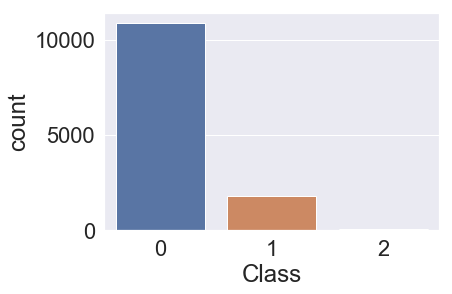

In [148]:
ax = sns.countplot(x=Y)

In [149]:
Y[Y==0].value_counts()

0    10865
Name: Class, dtype: int64

In [150]:
print(Y[Y==0].value_counts()/Y.shape[0])
print(Y[Y==1].value_counts()/Y.shape[0])
print(Y[Y==2].value_counts()/Y.shape[0])

0    0.851556
Name: Class, dtype: float64
1    0.142331
Name: Class, dtype: float64
2    0.006113
Name: Class, dtype: float64


In [151]:
Y[Y==1].value_counts()

1    1816
Name: Class, dtype: int64

In [152]:
Y[Y==2].value_counts()

2    78
Name: Class, dtype: int64

In [153]:
X = result_new.values
X.shape

(12759, 1853)

In [154]:
from scipy.linalg import svd
# define a matrix
# SVD
U, s, VT = svd(X)

In [156]:
from sklearn import preprocessing
X_norm = X #preprocessing.normalize(X, norm='l2')
X.shape

(12759, 1853)

In [157]:
feature_names = result_new.columns

In [158]:
n_top_words = 10
n_components = 6
random_seed = 10
num_example = X.shape[0]
num_example

12759

In [159]:
def print_top_words(model, feature_names, n_top_words):
    for topic_idx, topic in enumerate(model.components_):
        message = "Topic #%d: " % topic_idx
        message += ", ".join([feature_names[i]
                             for i in topic.argsort()[:-n_top_words - 1:-1]])
        print(message)
    print()

In [160]:
def print_top_index(model, feature_names, n_top_words):
    index_list = []
    for topic_idx, topic in enumerate(model.components_):
        message = "Topic #%d: " % topic_idx
        for i in topic.argsort()[:-n_top_words - 1:-1]:
            message = message + str(i)+', '
            index_list.append(i)
        print(message)
    return index_list
        
    print()

In [161]:
t0 = time.time()
nmf_f = NMF(n_components=n_components, random_state=random_seed,
                alpha=.1, l1_ratio=.5).fit(X_norm)
print("done in %0.3fs." % (time.time() - t0))
print("\nTopics in NMF model (Frobenius norm):")
print_top_words(nmf_f, feature_names, n_top_words)

done in 7.353s.

Topics in NMF model (Frobenius norm):
Topic #0: 509.1, 480, 507, 508, 458.9, 427.7, 512.9, 276.14, 994.2, 038
Topic #1: 745, 1010, 760, 773, 798, 512.8, 418, 401.1, 740.9, 785
Topic #2: 411.4, 401.1, 272.1, 428.1, 418, 427.21, 411.8, 512.7, 395.1, 416
Topic #3: 197, 318, 165.1, 510, 798, 198.1, 198.2, 789, 418, 512.7
Topic #4: 250.2, 401.22, 585.3, 250.3, 250.24, 585.33, 250.22, 250.1, 250.6, 585.1
Topic #5: 572, 785, 571.51, 287.3, 571.8, 571.81, 571.5, 573, 530.2, 789



In [163]:
# # nmf_k = NMF(n_components=n_components, random_state=random_seed,
# #                 beta_loss='kullback-leibler', solver='mu', max_iter=1000, alpha=.1,
# #                 l1_ratio=.5).fit(X_norm)
# # print("\nTopics in NMF model (kullback-leibler):")
# # print_top_words(nmf_k, feature_names, n_top_words)

# lda = LatentDirichletAllocation(n_components=n_components, max_iter=10,
#                                     learning_method='online',
#                                     learning_offset=50.,
#                                     random_state=random_seed).fit(X)
# print("\nTopics in LDA model:")
# print_top_words(lda, feature_names, n_top_words)

In [164]:
# top_word_list = print_top_index(nmf_f, feature_names, n_top_words)

# loading the phenotype names

In [166]:
df_ph_dicts = pd.read_csv("../data/raw/JD_CODE_string.csv", usecols=['PheCode', 'Short_names'],dtype=str, header=0)

In [167]:
df_ph_dicts.dtypes

PheCode        object
Short_names    object
dtype: object

In [168]:
df_ph_dicts.shape

(1866, 2)

In [169]:
df_ph_dicts.loc[df_ph_dicts['PheCode']=='411.4']['Short_names'].item()

'Coronary atherosclerosis'

In [170]:
features = df.drop(['GRID','Dob_year', 'Class','Age','Sex','MH', 'EHR_years'],axis=1).columns
phecode = list(features)
phecode[-1:]

['996']

In [171]:
phecodes_dict = []
for item in phecode:
    if item.startswith("00"):
        item = item[2:]
    elif item.startswith("0"):
        item = item[1:]
    phecodes_dict.append(df_ph_dicts.loc[df_ph_dicts['PheCode']==item]['Short_names'].item())

In [172]:
feature_names = phecodes_dict
len(feature_names)

1853

In [173]:
phecodes_dict[:4]

['Intestinal infection',
 'Bacterial enteritis',
 'Intestinal e.coli',
 'Intestinal infection due to C. difficile']

## print out other model NMF K and LDA

In [174]:
print_top_words(nmf_f, feature_names, n_top_words)

Topic #0: Respiratory failure, Pneumonia, Pleurisy, Pulmonary collapse; interstitial/compensatory emphysema, Hypotension NOS, Tachycardia NOS, Other dyspnea, Hypopotassemia, Sepsis, Septicemia
Topic #1: Pain in joint, Other tests, Back pain, Pain in limb, Malaise and fatigue, Cough, Nonspecific chest pain, Essential hypertension, Osteoarthrosis NOS, Abdominal pain
Topic #2: Coronary atherosclerosis, Essential hypertension, Hyperlipidemia, Congestive heart failure NOS, Nonspecific chest pain, Atrial fibrillation, Chronic ischemic heart disease, Shortness of breath, Nonrheumatic mitral valve disorders, Cardiomegaly
Topic #3: Chemotherapy, Tobacco use disorder, Lung cancer, Other diseases of lung, Malaise and fatigue, Secondary malignancy of lymph nodes, Secondary malignancy of lung, Nausea and vomiting, Nonspecific chest pain, Shortness of breath
Topic #4: Type 2 diabetes, Hypertensive chronic kidney disease, Chronic renal failure, Insulin pump user, Type 2 diabetic neuropathy, Chronic K

In [175]:
# print_top_words(lda, feature_names, n_top_words)

## visualize the topic-word and patient-topic

In [176]:
topic_model = nmf_f

In [177]:
print_top_words(topic_model, feature_names, n_top_words)

Topic #0: Respiratory failure, Pneumonia, Pleurisy, Pulmonary collapse; interstitial/compensatory emphysema, Hypotension NOS, Tachycardia NOS, Other dyspnea, Hypopotassemia, Sepsis, Septicemia
Topic #1: Pain in joint, Other tests, Back pain, Pain in limb, Malaise and fatigue, Cough, Nonspecific chest pain, Essential hypertension, Osteoarthrosis NOS, Abdominal pain
Topic #2: Coronary atherosclerosis, Essential hypertension, Hyperlipidemia, Congestive heart failure NOS, Nonspecific chest pain, Atrial fibrillation, Chronic ischemic heart disease, Shortness of breath, Nonrheumatic mitral valve disorders, Cardiomegaly
Topic #3: Chemotherapy, Tobacco use disorder, Lung cancer, Other diseases of lung, Malaise and fatigue, Secondary malignancy of lymph nodes, Secondary malignancy of lung, Nausea and vomiting, Nonspecific chest pain, Shortness of breath
Topic #4: Type 2 diabetes, Hypertensive chronic kidney disease, Chronic renal failure, Insulin pump user, Type 2 diabetic neuropathy, Chronic K

In [178]:
X_topics = topic_model.transform(X) # each patient's distribution or score on each topic
threshold = 0
_idx = np.amax(X_topics, axis=1) >= threshold  # idx of patients that > threshold
_topics = X_topics[_idx]
print('selected:', len(_topics))
_raw_doc = X[_idx]

selected: 12759


In [179]:
X.shape

(12759, 1853)

In [180]:
X_topics.shape

(12759, 6)

In [181]:
_raw_doc.shape

(12759, 1853)

In [239]:
from sklearn import preprocessing 
X_topics_norm = preprocessing.normalize(X_topics,norm='l2')

In [240]:
columns = [str(i) for i in range(0,n_components)]
dtm_to_topic = pd.DataFrame(X_topics_norm,columns=columns) #patients distribution on each topi
dtm_to_topic.head(10)

,0,1,2,3,4,5
0,0.261703,0.631758,0.663370,0.000000,0.303866,0.000000
1,0.000000,0.933649,0.075710,0.000000,0.350097,0.000000
2,0.000000,0.475533,0.168513,0.000000,0.863407,0.000000
3,0.000000,0.998901,0.046867,0.000000,0.000000,0.000000
4,0.177549,0.207022,0.123927,0.905936,0.298991,0.012020
5,0.655477,0.205202,0.000000,0.239808,0.461409,0.507775
6,0.000000,0.159917,0.751942,0.535493,0.349652,0.000000
7,0.063510,0.370462,0.512708,0.034218,0.752564,0.168321
8,0.687918,0.090035,0.518428,0.205017,0.455921,0.000000
9,0.483437,0.116411,0.744218,0.172550,0.411221,0.000000


In [241]:
df_group = pd.melt(dtm_to_topic,value_vars=columns)
df_group.head()

,variable,value
0,0,0.261703
1,0,0.000000
2,0,0.000000
3,0,0.000000
4,0,0.177549


In [242]:
df_group = df_group.rename(columns={'variable':'Topics', 'value':'Score'})

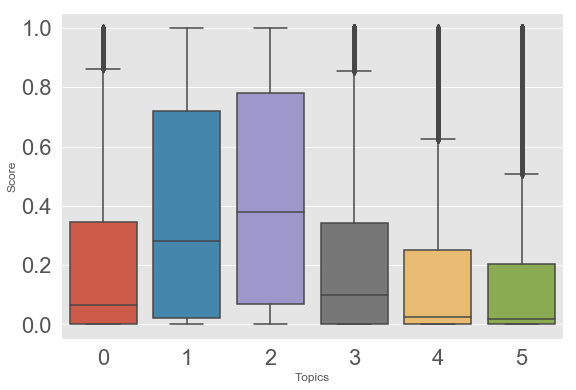

In [244]:
fig = plt.figure(figsize=(9,6))
ax = sns.boxplot(x="Topics", y="Score", data=df_group)
plt.savefig(path.join('images', 'boxplot_w.eps'), format='eps', dpi=300)

In [186]:
dtm_to_topic.columns

Index(['Topic_0', 'Topic_1', 'Topic_2', 'Topic_3', 'Topic_4', 'Topic_5'], dtype='object')

In [187]:
patients_id = df[['GRID','Class','Age']]
patients_id.shape

(12759, 3)

In [188]:
dtm_to_topic.shape

(12759, 6)

In [189]:
dtm_to_topic.shape

(12759, 6)

In [190]:
dtm_to_topic.tail()

,Topic_0,Topic_1,Topic_2,Topic_3,Topic_4,Topic_5
12754,0.000000,0.0,0.000000,0.000000,0.000000,0.000000
12755,0.053832,0.0,0.946168,0.000000,0.000000,0.000000
12756,0.000000,0.0,0.000000,1.000000,0.000000,0.000000
12757,0.035248,0.0,0.000000,0.964752,0.000000,0.000000
12758,0.174633,0.0,0.000000,0.059239,0.307817,0.458311


In [191]:
patients_id.tail()

,GRID,Class,Age
12754,R280014493,1,97
12755,R270117741,1,62
12756,R284443305,1,69
12757,R271449404,0,69
12758,R223733135,0,67


In [192]:
dtm_to_topic_grid = pd.concat([patients_id,dtm_to_topic],axis=1)
dtm_to_topic_grid.head()

,GRID,Class,Age,Topic_0,Topic_1,Topic_2,Topic_3,Topic_4,Topic_5
0,R229819105,0,81,0.140648,0.339528,0.356517,0.000000,0.163307,0.000000
1,R208614966,0,79,0.000000,0.686781,0.055691,0.000000,0.257528,0.000000
2,R215976946,0,82,0.000000,0.315455,0.111787,0.000000,0.572758,0.000000
3,R263516844,0,78,0.000000,0.955184,0.044816,0.000000,0.000000,0.000000
4,R296513688,0,78,0.102900,0.119982,0.071823,0.525045,0.173283,0.006967


In [193]:
_lda_keys = [] # top topics for each docs
for i, doc in enumerate(_raw_doc):
    _lda_keys += _topics[i].argmax(),

print(len(_lda_keys))
dtm_top_topic = pd.DataFrame(_lda_keys,columns=['Topic'])
print(dtm_top_topic.shape)
dtm_top_topic.head()

12759
(12759, 1)


,Topic
0,2
1,1
2,4
3,1
4,3


In [194]:
import os
import errno
def _mkdir_p(path):
    try:
        os.makedirs(path)
    except OSError as exc: # Python >2.5
        if exc.errno == errno.EEXIST and os.path.isdir(path):
            pass
        else: raise

In [195]:
dtm_top_topic[dtm_top_topic['Topic']==2].shape[0]/dtm_top_topic.shape[0]

0.3327847009953758

In [196]:
dtm_top_topic[dtm_top_topic['Topic']==3].shape[0]

1801

In [197]:
dtm_top_topic[dtm_top_topic['Topic']==3].shape[0]/dtm_top_topic.shape[0]

0.141155262951642

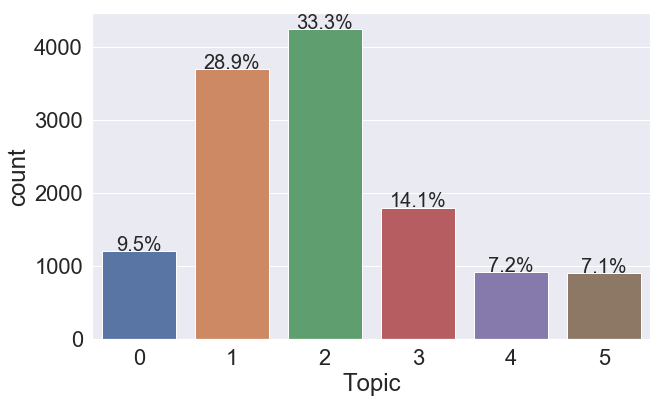

In [198]:
import seaborn as sns
total = dtm_top_topic.shape[0] # one person per row 
plt.figure(figsize=(10,6))

ax = sns.countplot(x=dtm_top_topic["Topic"])
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:.1%}'.format(height/total),
            ha="center",fontsize=20) 
folder_path = 'images/nmf_f_'+str(n_components)
_mkdir_p(folder_path)
plt.savefig(folder_path+'/Topic_distribution.png', dpi=300)
plt.savefig(folder_path+'/Topic_distribution.eps', dpi=300)

## Calucate pearson assocation
Calculates a Pearson correlation coefficient and the p-value for testing non-correlation.
The Pearson correlation coefficient measures the linear relationship between two datasets. Strictly speaking, Pearson’s correlation requires that each dataset be normally distributed. Like other correlation coefficients, this one varies between -1 and +1 with 0 implying no correlation. Correlations of -1 or +1 imply an exact linear relationship. Positive correlations imply that as x increases, so does y. Negative correlations imply that as x increases, y decreases. The p-value roughly indicates the probability of an uncorrelated system producing datasets that have a Pearson correlation at least as extreme as the one computed from these datasets. The p-values are not entirely reliable but are probably reasonable for datasets larger than 500 or so. The correlation coefficient can range from -1 to +1. The null hypothesis is that the two variables are uncorrelated. The p-value is a number between zero and one that represents the probability that your data would have arisen if the null hypothesis were true.

In [199]:
def get_X_y(topic_idx, dtm_topic):
    Cov_topic = 'Topic_'+str(topic_idx)
    Y = dtm_topic.Class
    Y_age = dtm_topic.Age
    X_topic = dtm_topic[Cov_topic].values
    return X_topic, Y

In [200]:
from scipy.stats import pearsonr
for topic_idx in range(n_components):
    X_topic,Y = get_X_y(topic_idx,dtm_to_topic_grid)
    print('LPA SNPs and topic_'+str(topic_idx), pearsonr(X_topic,Y))

LPA SNPs and topic_0 (0.007441040946211339, 0.40066307566764825)
LPA SNPs and topic_1 (-0.020652220097025872, 0.01965827188232305)
LPA SNPs and topic_2 (0.06232371253817558, 1.84158776390013e-12)
LPA SNPs and topic_3 (-0.04205069114538794, 2.0190987223056384e-06)
LPA SNPs and topic_4 (-0.008392510497953443, 0.34317727089448635)
LPA SNPs and topic_5 (-0.014646011797325081, 0.09807108404057777)


In [201]:
topic_word = topic_model.components_ 
topic_word_fequency = 100*topic_model.components_ 

In [202]:
topic_word.shape

(6, 1853)

In [203]:
topic_word = preprocessing.normalize(topic_word, norm='l2')

In [205]:
hot=topic_word[:,:]>0.2
hot.shape

(6, 1853)

In [206]:
import seaborn as sns
plt.figure(figsize=(10,8))
sns.set(font_scale=2)
topic_word_norm=components_=preprocessing.normalize(topic_word, norm='l2')
topic_word_norm.shape

(6, 1853)

<Figure size 720x576 with 0 Axes>

In [208]:
np.mean(topic_word_norm,axis=0)

array([2.77604563e-03, 9.43906368e-04, 8.68009483e-05, ...,
       3.37374139e-02, 1.85241221e-02, 6.48011028e-04])

In [209]:
# ax = sns.heatmap(topic_word_norm[3:6,list(u)],cbar=False)
# plt.savefig('images/heatmap.jpg', dpi=300,bbox_inches='tight')

In [211]:
topic_word_fequency.shape

(6, 1853)

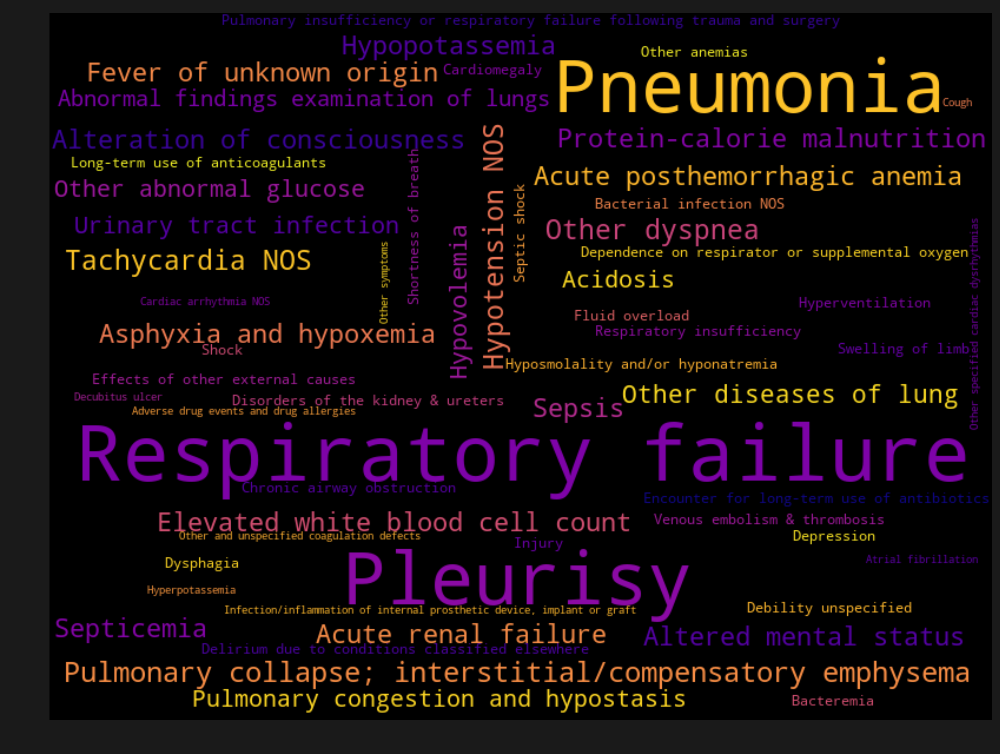

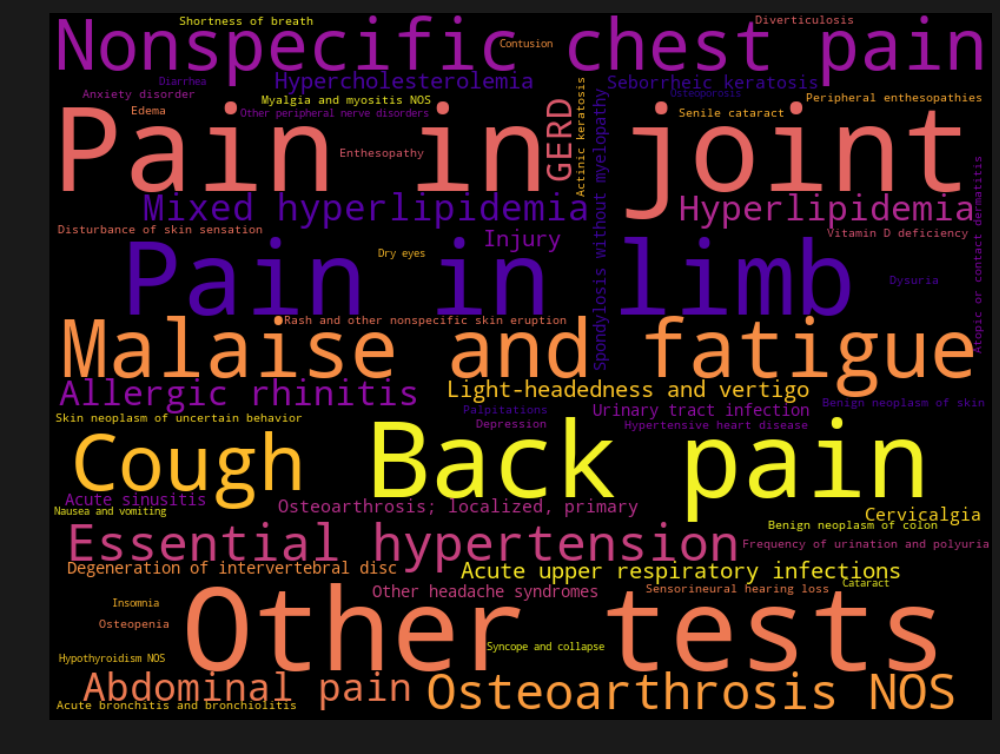

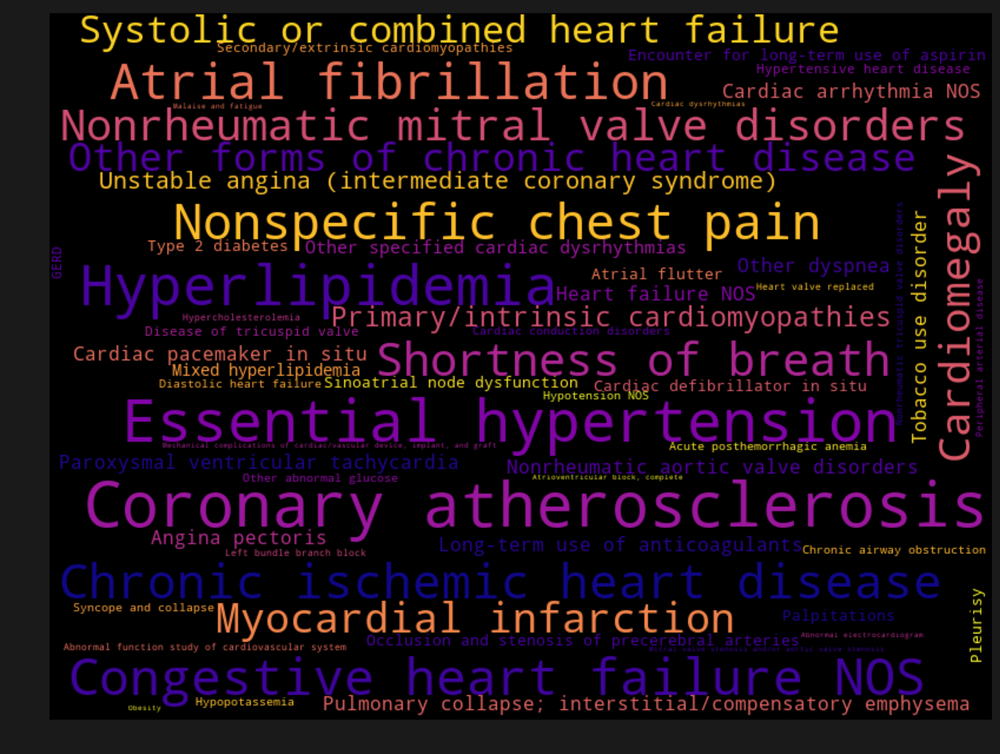

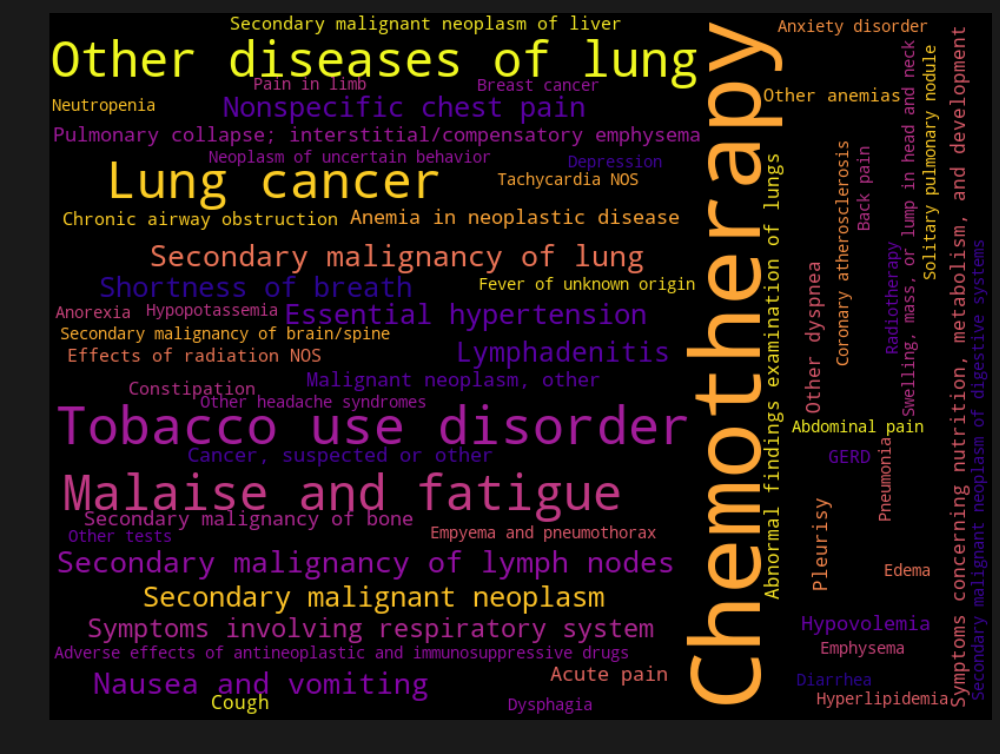

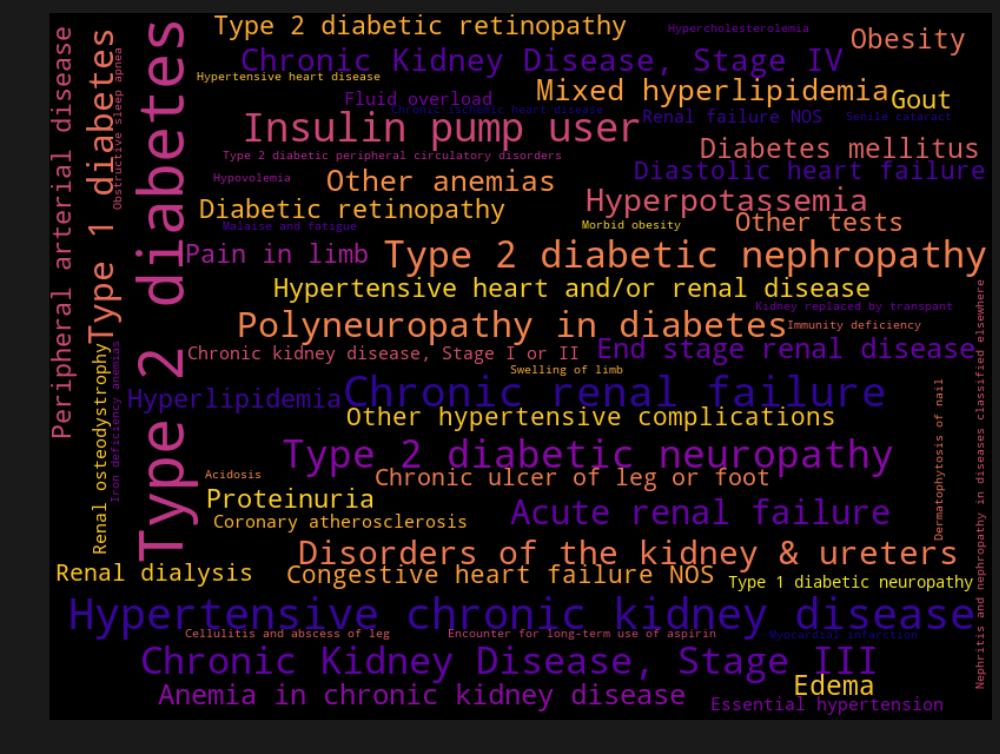

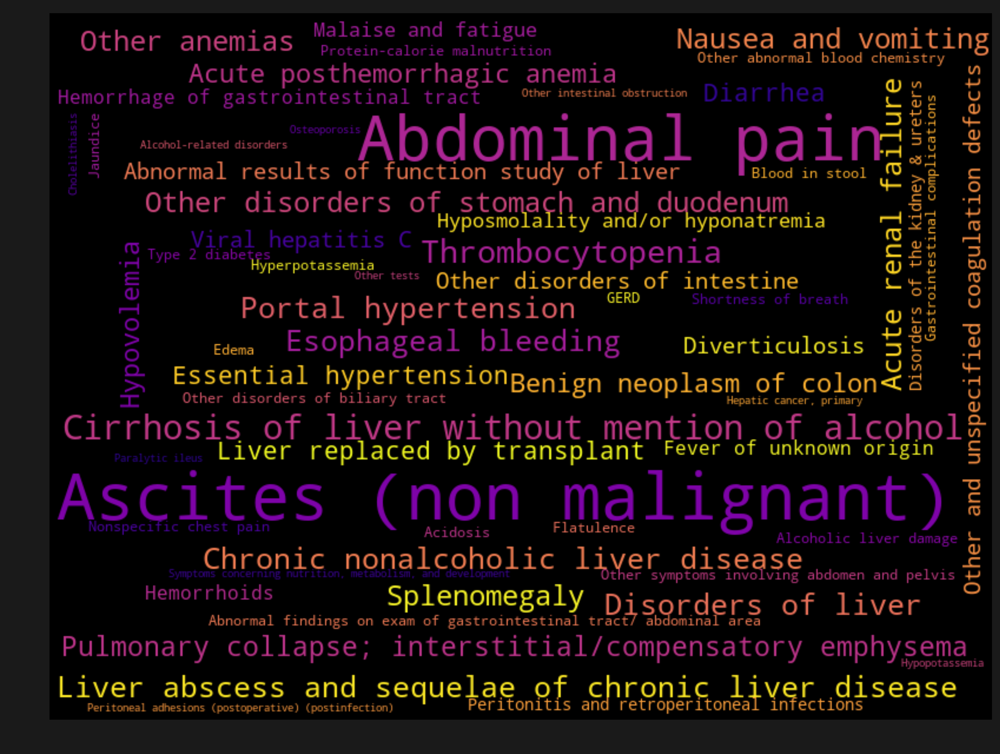

In [214]:
my_dpi=300

from wordcloud import ImageColorGenerator
from PIL import Image

for topic_index in np.arange(n_components):
    word_frequency_per_topic = topic_word_fequency[topic_index,:]
    word_frequency_dic = dict(zip(feature_names, word_frequency_per_topic))
    word_cloud = WordCloud(width=800, height=600,max_words=60,colormap='plasma',#ackground_color="rgba(255, 255, 255, 0)", mode="RGBA")
                          ).generate_from_frequencies(word_frequency_dic)
#     word_cloud.recolor(color_func=image_colors)
#     word_cloud.to_file(folder_path +'/Topic_T'+str(topic_index)+'_11fig.png')

    plt.figure(figsize=(20.5,14), facecolor='k', dpi=300 )
    plt.imshow(word_cloud, interpolation="bilinear")
    plt.axis("off")
#     plt.title("Topic_"+str(topic_index))
#     plt.savefig(folder_path+'/Topic_T'+str(topic_index)+'_fig.eps', format='eps', dpi=my_dpi,bbox_inches='tight')
#     plt.show() 